In [76]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [77]:
import pandas as pd

# Load the log file into a DataFrame
df = pd.read_csv('HealthApp.csv')
df.rename(columns={'Unnamed: 0':'index', '0':'timestamp', '1':'module', '2':'identifier', '3':'message'}, inplace=True)

In [78]:
df.head()
df.columns.values
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 238723 entries, 0 to 238722
Data columns (total 8 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   index       238723 non-null  int64  
 1   timestamp   238723 non-null  object 
 2   module      238723 non-null  object 
 3   identifier  238723 non-null  int64  
 4   message     238723 non-null  object 
 5   4           18 non-null      float64
 6   5           18 non-null      float64
 7   6           18 non-null      float64
dtypes: float64(3), int64(2), object(3)
memory usage: 14.6+ MB


In [79]:
# Drop duplicate rows
df.drop_duplicates(inplace=True)

# Filter out irrelevant modules
module_unique = df['module'].unique()
df = df[df['module'].isin(module_unique)]

# Convert the timestamp column to a datetime object
df['timestamp'] = pd.to_datetime(df['timestamp'], format='%Y%m%d-%H:%M:%S:%f')


               index  identifier             4            5             6
count  238723.000000    238723.0     18.000000    18.000000     18.000000
mean   119361.000000  30002312.0   6252.833333   729.760000   2231.500000
std     68913.538493         0.0   7930.663857  1697.167446   4295.842522
min         0.000000  30002312.0      0.000000     0.000000      0.000000
25%     59680.500000  30002312.0     53.500000     0.000000      0.000000
50%    119361.000000  30002312.0   2052.000000     0.000000      0.000000
75%    179041.500000  30002312.0  11180.000000     7.210000      0.000000
max    238722.000000  30002312.0  26302.000000  5017.000000  10109.000000


<AxesSubplot: title={'center': 'identifier'}, xlabel='module'>

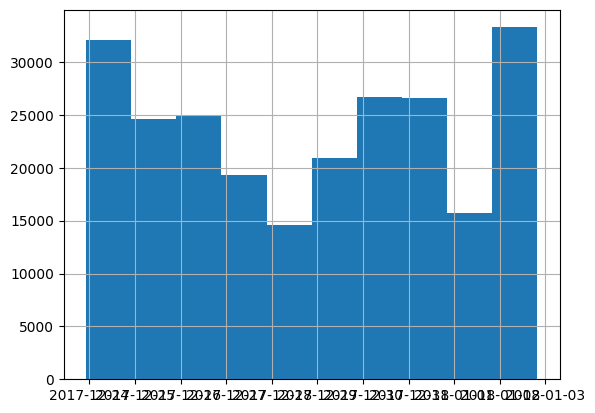

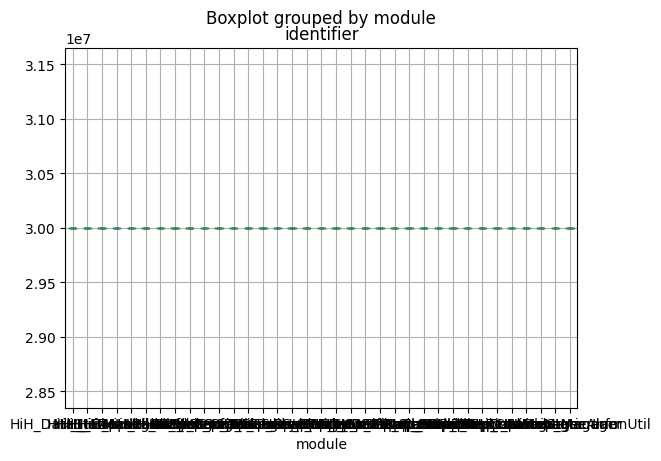

In [80]:
# Get summary statistics of the numeric columns
print(df.describe())

# Plot a histogram of the timestamp column
df['timestamp'].hist()

# Plot a boxplot of the identifier column
df.boxplot(column='identifier', by='module')


<AxesSubplot: >

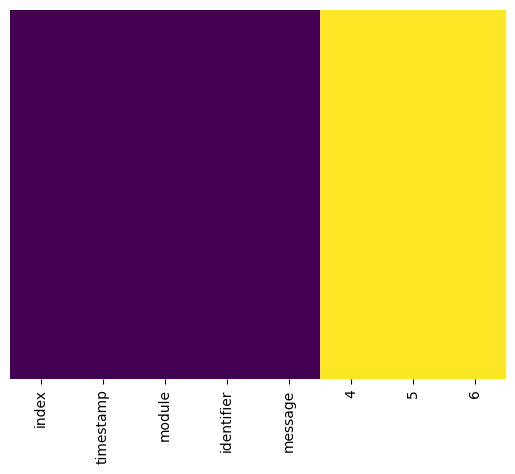

In [81]:
sns.heatmap(df.isnull(),cbar=False,yticklabels=False,cmap = 'viridis')

In [82]:
from sklearn.cluster import DBSCAN
import numpy as np

# Convert the timestamp column to Unix timestamps
df['timestamp_uni'] = df['timestamp'].astype(np.int64) // 10 ** 9

# Cluster the data using the DBSCAN algorithm
X = df[['timestamp_uni', 'identifier']].values
dbscan = DBSCAN(eps=60, min_samples=10)
labels = dbscan.fit_predict(X)

# Add the cluster labels to the DataFrame
df['cluster'] = labels


In [83]:
# Get the number of log entries per cluster
cluster_counts = df['cluster'].value_counts()

# Get the clusters with the most log entries
top_clusters = cluster_counts.head(10).index.tolist()

# Get the messages associated with the top clusters
top_messages = df[df['cluster'].isin(top_clusters)]['message'].unique()

# Print the messages
# print('Top messages:')
# for msg in top_messages:
#     print('- ' + msg)


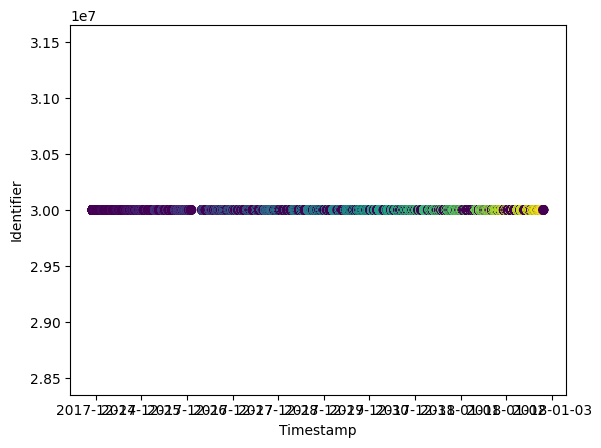

In [84]:
import matplotlib.pyplot as plt

# Create a scatter plot of the log entries, colored by cluster
plt.scatter(df['timestamp'], df['identifier'], c=df['cluster'])
plt.xlabel('Timestamp')
plt.ylabel('Identifier')
plt.show()


In [85]:
import plotly.express as px

# Create a timeline chart of the log entries, colored by cluster
fig = px.timeline(df, x_start='timestamp', x_end='timestamp', y='message', color='cluster')
fig.show()


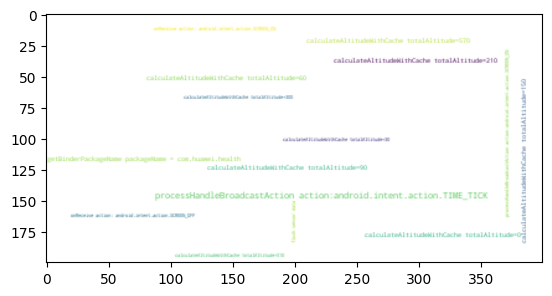

In [86]:
from wordcloud import WordCloud

# Get the most common log messages
top_messages = df['message'].value_counts().head(50)

# Generate a word cloud of the log messages
wordcloud = WordCloud(background_color='white').generate_from_frequencies(top_messages)

# Display the word cloud
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('on')
plt.show()


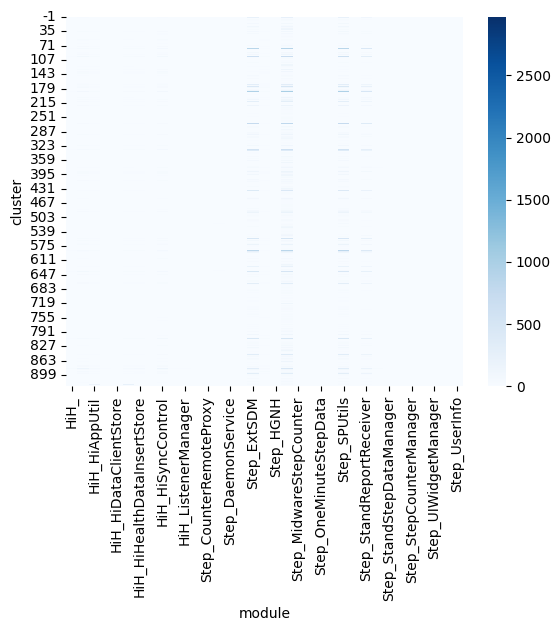

In [87]:

# Create a heatmap of the log entries, colored by cluster
heatmap_data = df.groupby(['cluster', 'module']).size().unstack(fill_value=0)
sns.heatmap(heatmap_data, cmap='Blues')
plt.show()
